# **En este notebook el alumno aprende a utilizar Faster R-CNN**

## Faster R-CNN



### ¿Que es Faster R-CNN?

Faster R-CNN es un modelo avanzado de detección de objetos en imágenes ampliamente utilizado. Su objetivo es identificar y localizar múltiples objetos dentro de una imagen, proporcionando tanto las clases de los objetos como sus bounding boxes.

Este modelo está basado en una arquitectura de dos etapas que explicaremos a continuación, pero para
entender bien como funciona Faster R-CNN hay que ir un poco atrás en el tiempo.

#### Evolución desde R-CNN hasta Faster R-CNN


##### R-CNN. Girshick et al., “Rich feature hierarchies for accurate object detection and semantic segmentation”, CVPR 2014.

El modelo R-CNN (Region-based Convolutional Neural Network) fue pionero en combinar redes neuronales convolucionales con propuestas de regiones para la detección de objetos. El proceso implicaba generar alrededor de 2000 propuestas de regiones por imagen mediante métodos como la búsqueda selectiva (Selective Search). Cada región se redimensionaba y se procesaba individualmente a través de una CNN para extraer características, que luego se clasificaban utilizando máquinas de vectores de soporte (SVM). Aunque R-CNN mejoró la precisión en comparación con métodos anteriores, su principal desventaja era la **ineficiencia computacional**, ya que cada región propuesta se procesaba por separado, resultando en tiempos de inferencia prolongados.

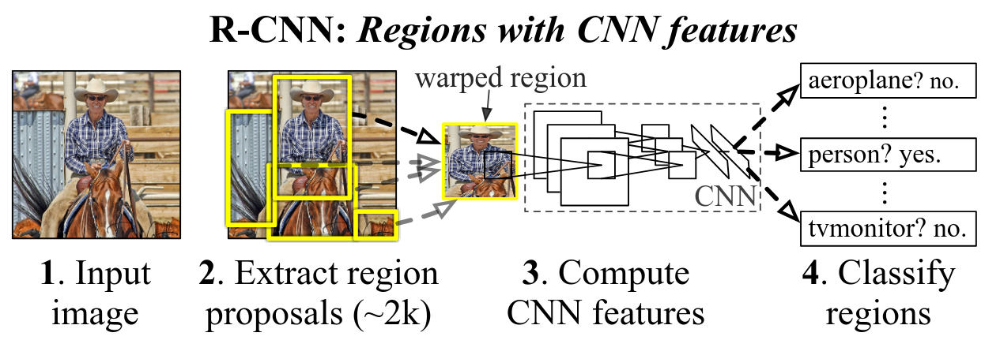

Imagen extraida de Girshick et al., “Rich feature hierarchies for accurate object detection and semantic segmentation”, CVPR 2014.


#### Fast R-CNN Girshick et al., "Fast R-CNN", ICCV 2015.

Fast R-CNN introdujo mejoras significativas en eficiencia al abordar las limitaciones de R-CNN. En lugar de procesar cada región propuesta por separado, Fast R-CNN procesaba la **imagen completa** a través de una CNN para generar un mapa de características. Las propuestas de regiones se proyectaban sobre este mapa y se extraían mediante una operación denominada RoI Pooling, que ajustaba las regiones a un tamaño fijo, preservando la información espacial relevante. Posteriormente, estas características se utilizaban para predecir simultáneamente las clases de los objetos y refinar las coordenadas de las cajas delimitadoras. Este enfoque redujo significativamente la redundancia y mejoró la velocidad de procesamiento.

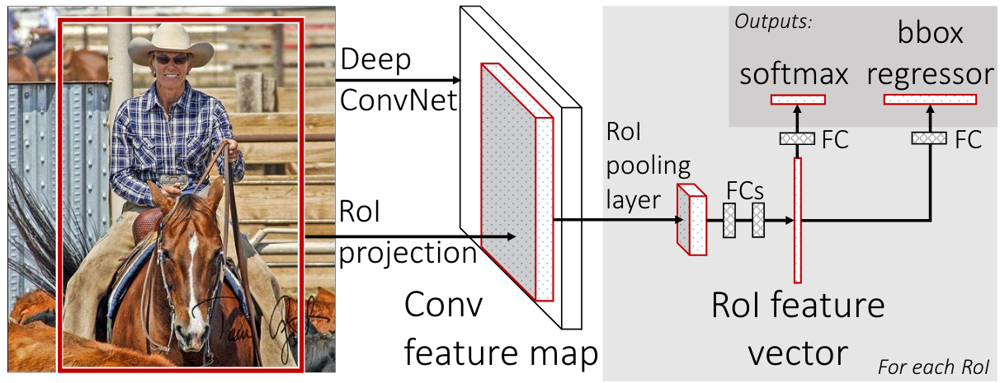

Imagen extraida de Girshick et al., "Fast R-CNN", ICCV 2015.

#### Faster R-CNN Ren et al., “Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks”, NIPS 2015

Faster R-CNN introduce la Red de Propuestas de Regiones (RPN), que está integrada en la arquitectura y genera propuestas de regiones de manera eficiente . Esto elimina la necesidad de **métodos externos** y permite un entrenamiento conjunto de la RPN y la red de detección, mejorando la precisión y velocidad.

Vamos a explicar de forma detallada su arquitectura así como su funcionamiento.

La arquitectura de Faster R-CNN se basa en tres bloques principales:

1. **Backbone:** Una red neuronal convolucional profunda, como Alexnet, VGG-16 o ResNet, que extrae características de la imagen de entrada.

2. **Red de Propuestas de Región (RPN):** Es una red completamente convolucional que genera propuestas de regiones de interés (Region of Interest o RoI) a partir del mapa de características proporcionado por el backbone. La RPN evalúa múltiples **anchors** en cada posición del mapa de características, prediciendo la probabilidad de que cada anchor contenga un objeto y refinando sus coordenadas.

3. **Clasificador y Regressor de bounding boxes:** Las propuestas de regiones generadas por la RPN se ajustan a un tamaño fijo mediante una operación de RoI Pooling o RoI Align y se procesan para clasificar el contenido de cada región y refinar las coordenadas de las cajas delimitadoras, mejorando la precisión en la localización de los objetos.




Hemos introducido un nuevo concepto, las anchors o anclas por lo que vamos a pasar a explicar brevemente que son.

Una anchor es una caja rectangular centrada en un punto específico del mapa de características, con dimensiones predeterminadas $(1\times20\times15)$ que reflejan diferentes escalas y relaciones de aspecto. Estas cajas sirven como candidatos iniciales para las regiones que podrían contener objetos.

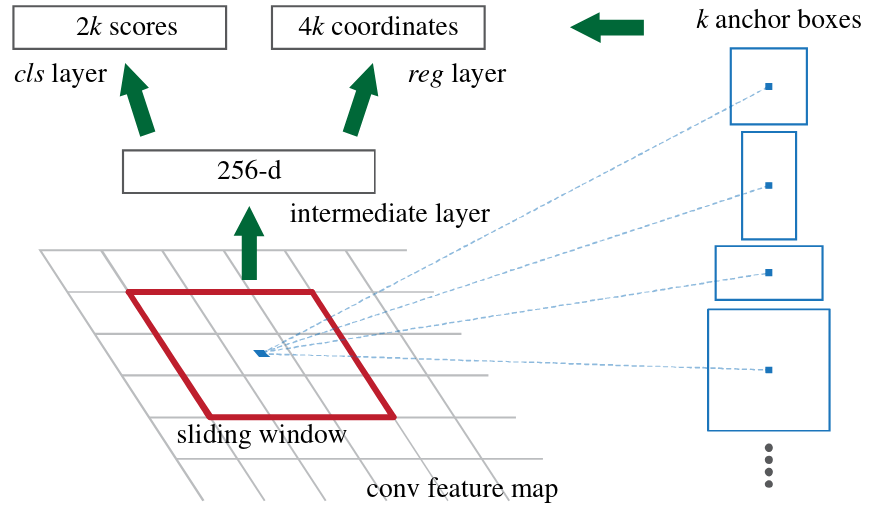

Imagen extraida de Ren et al., “Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks”, NIPS 2015

#### Funcionamiento

El funcionamiento se puede dividir en grandes rasgos en **dos** etapas:

1. **Generación de Propuestas de Región:** La RPN escanea el mapa de características extraido por el backbone y, en cada posición, evalúa múltiples anchors de diferentes escalas y relaciones de aspecto. Para cada anchor, la RPN predice una puntuación de objectness y ajustes en las coordenadas, generando así propuestas de regiones que **probablemente** contengan objetos.

2. **Clasificación y Refinamiento:** Las propuestas de regiones se ajustan a un tamaño fijo y se procesan para determinar la clase del objeto presente y refinar las coordenadas de las bounding boxes, asegurando una detección precisa.

Esta división hace que Faster R-CNN sea un modelo de dos etapas a diferencia de los otros modelos que vamos a usar.

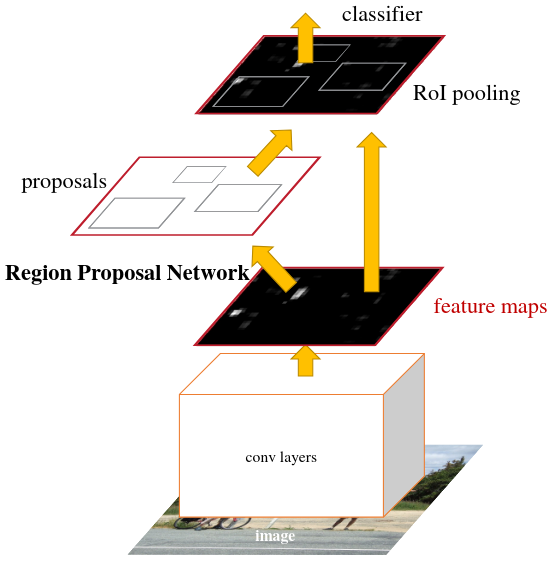

Imagen extraida de Ren et al., “Faster R-CNN: Towards Real-Time Object Detection with Region Proposal Networks”, NIPS 2015

### Carga y Formato de Datos



En este caso por reutilizar la mayor cantidad de código posible, hemos decidido descargar
las etiquetas en formato YOLO para luego convertirlas al formato correspondiente.

En este caso Faster RCNN es similar al formato [COCO](https://cocodataset.org/), aunque con diferencias.
La mas notable de estas es el formato de las bounding boxes el cual es el siguiente:

$$
    \left[ x_{min}, y_{min}, x_{max}, y_{max} \right]
$$

a diferencia del formato YOLO.

$$
\left[ classid, x_{center}, y_{center}, width, height \right]
$$

Además de esto, Faster RCNN no tiene un formato 100% estándar por lo que depende de la
libreria que se use recibirá los datos de una forma u otra.

En este caso, pytorch espera recibir las etiquetas como un **diccionario** con dos
claves, `boxes` con las bounding boxes en el formato especificado y `labels` con
las etiquetas de los objetos. Hay que tener en cuenta que la etiqueta 0 esta asociada
a la clase `background` por lo que no la podemos usar.

Una vez explicado el formato vamos a implementar la clase `YoloToFasterRCNN` la cual
va a reusar la clase definida previamente la cual lee las etiquetas y las imágenes
y las devuelve en el formato en el que se descargaron, sin ningún procecesado.

De aquí simplemente modificaremos las equiquetas y las convertiremos al formato
explicado.

In [ ]:
class YoloToFasterRCNN(Dataset):
    def __init__(self, images_dir, labels_dir, transform=None):
        self.yolo_ds = CustomDataset(images_dir, labels_dir, transform)

    def __len__(self):
        return len(self.yolo_ds)

    def __getitem__(self, idx):
        yolo_im, yolo_lab = self.yolo_ds[idx]
        faster_lab = self.yolo_to_faster(yolo_lab, yolo_im.shape)

        return yolo_im, faster_lab

    def yolo_to_faster(self, yolo_lab, img_shape):
        faster_lab = {}
        positions = []

        width_img, height_img = img_shape[1], img_shape[2]

        for lab in yolo_lab:
            _, x_center, y_center, width, height = map(float, lab)
            x_min = int((x_center - width / 2) * width_img)
            y_min = int((y_center - height / 2) * height_img)
            x_max = int((x_center + width / 2) * width_img)
            y_max = int((y_center + height / 2) * height_img)

            if x_min <= 0 or y_min <= 0 or x_max <= 0 or x_min <= 0:
                # positions.append(torch.tensor([1, 1, 2, 2]))
                continue

            positions.append(torch.tensor([x_min, y_min, x_max, y_max]))

        if len(positions) != 0:
            faster_lab['boxes'] = torch.stack(positions)
        else:
            faster_lab['boxes'] = torch.empty((0, 4), dtype=torch.float32)

        faster_lab['labels'] = torch.ones(len(positions), dtype=torch.int64) # only 1 class, plane

        return faster_lab

Una vez que tenemos definido el `dataset`, vamos a cargar los tres conjuntos con los que vamos
a trabajar, en nuestro caso entrenamiento, validación y test.

In [ ]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
])

ds_faster_train = YoloToFasterRCNN(images_dir=PATH_IMG_TRAIN, labels_dir=PATH_LABEL_TRAIN, transform=transform)
ds_faster_valid = YoloToFasterRCNN(images_dir=PATH_IMG_VAL, labels_dir=PATH_LABEL_VAL, transform=transform)
ds_faster_test = YoloToFasterRCNN(images_dir=PATH_IMG_TEST, labels_dir=PATH_LABEL_TEST, transform=transform)

Para poder visualizar las imágenes junto con sus bounding boxes, vamos a definir la
función `draw_img_bb_fasterrcnn` la cual recibirá las imágenes y las etiquetas como
parámetros y las mostrará por pantalla.

In [ ]:
def draw_img_bb_fasterrcnn(img: torch.Tensor, labels: torch.Tensor, ax=None, edgecolor='r', lw=2):
    if ax is None:
        fig, ax = plt.subplots(1, figsize=(10, 10))

    img = img.permute(1, 2, 0).cpu().detach().numpy()
    if img.max() <= 1.0:  # normalize
        img = (img * 255).astype('uint8')
    else:
        img = img.astype('uint8')

    ax.imshow(img)
    ax.axis('off')

    for label in labels:
        xmin, ymin, xmax, ymax = label.cpu().detach().numpy()
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                 linewidth=lw, edgecolor=edgecolor, facecolor='none')

        ax.add_patch(rect)

Vamos a verificar que tanto la implementación de `draw_img_bb_fasterrcnn` como del
`dataset` sea correcta mostrando la primera imagen del conjunto de entrenamiendo
junto con sus bounding boxes.

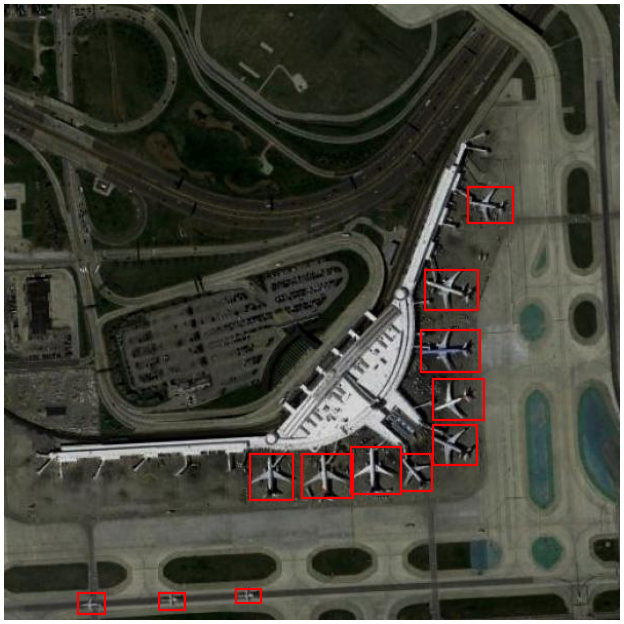

In [ ]:
draw_img_bb_fasterrcnn(ds_faster_train[0][0], ds_faster_train[0][1]['boxes'])

Podemos observar que la carga se ha realizado de forma correcta.

### Carga del Modelo

Para la carga y la creación del modelo, pytorch nos ofrece una función con la cual
podemos cargar el modelo de Faster RCNN. En este caso con un backbone basado en
ResNet50 y preentrenado con los datos de COCO-val2017.

En este caso, necesitamos modificar el modelo ligeramente ya que solo tenemos una única clase
para predecir y el modelo está adaptado a las 90 de COCO-val2017.

In [ ]:
def get_model_fasterrcnn(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights="DEFAULT")
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

    return model

Una vez definida la función que carga el modelo, vamos a proceder a cargarlo y
a enviarlo al dispositivo en el cual se trabajará.

In [ ]:
faster_rcnn = get_model_fasterrcnn(num_classes=2).to(DEVICE)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 149MB/s]


Vamos a ver cuantos parámetros tiene el modelo y cuantos de ellos son entrenables por
defecto, para ello en primera instancia intentamos usar la librería `torchsummary`
pero esta da problemas con la arquitectura de Faster RCNN por lo que hemos decidio
hacerlo a mano.

In [ ]:
total_params = 0
trainable_params = 0
for name, param in faster_rcnn.named_parameters():
    print(f"Parameter name: {name}")
    print(f"Requires Grad: {param.requires_grad}")
    print(f"Size: {param.size()}")
    print(f"Num Params: {param.numel()}")
    print("-" * 40)
    total_params += param.numel()
    if param.requires_grad:
        trainable_params += param.numel()

print(f'Total params: {total_params}')
print(f'Trainable params: {trainable_params}')

Parameter name: backbone.body.conv1.weight
Requires Grad: False
Size: torch.Size([64, 3, 7, 7])
Num Params: 9408
----------------------------------------
Parameter name: backbone.body.layer1.0.conv1.weight
Requires Grad: False
Size: torch.Size([64, 64, 1, 1])
Num Params: 4096
----------------------------------------
Parameter name: backbone.body.layer1.0.conv2.weight
Requires Grad: False
Size: torch.Size([64, 64, 3, 3])
Num Params: 36864
----------------------------------------
Parameter name: backbone.body.layer1.0.conv3.weight
Requires Grad: False
Size: torch.Size([256, 64, 1, 1])
Num Params: 16384
----------------------------------------
Parameter name: backbone.body.layer1.0.downsample.0.weight
Requires Grad: False
Size: torch.Size([256, 64, 1, 1])
Num Params: 16384
----------------------------------------
Parameter name: backbone.body.layer1.1.conv1.weight
Requires Grad: False
Size: torch.Size([64, 256, 1, 1])
Num Params: 16384
----------------------------------------
Parameter na

Podemos ver en este caso que las 11 primeras capas están congeladas por defecto, opción que se puede cambiar, pero tras varios experiementos hemos visto que el ajuste de estas capas hacen que el modelo sea bastante inestable durante el entrenamiento por lo que hemos decidido dejarlas congeladas.

Vamos a probar en primera instancia como funciona el modelo si realizar fine-tunning.

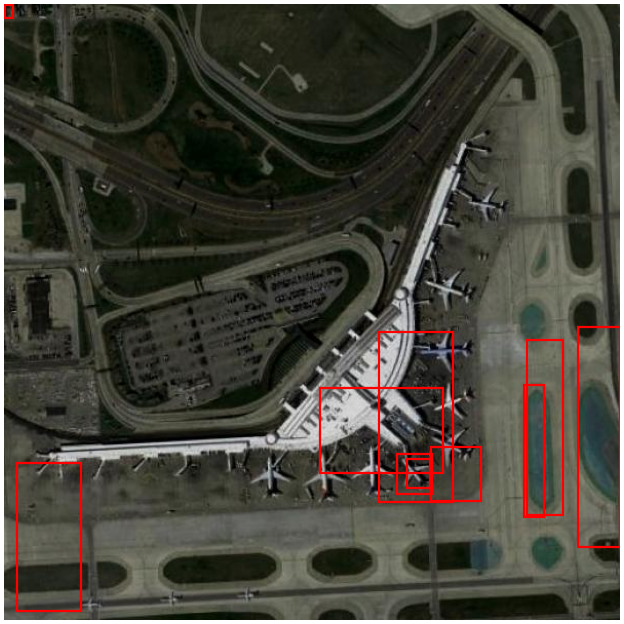

In [ ]:
faster_rcnn.eval()
preds = faster_rcnn([ds_faster_train[0][0].to(DEVICE)])
draw_img_bb_fasterrcnn(ds_faster_train[0][0], preds[0]['boxes'][:10])

Podemos ver como el modelo funciona muy mal por lo que el entrenamiento es necesario.

### Entrenamientos y Evaluaciones

Para entrenar Faster RCNN vamos a definir la función `train_fasterrcnn_one_epoch`
la cual como su nombre indica entrena el modelo por una época.

Recibe como parámetros el modelo a entrenar, el dataloader necesario, el dataloader de validación,
el optimizador y el planificador del learning rate que se va a usar.

Esta función nos va a devolver la evolución de las diferentes funciones de pérdida que
utiliza el modelo tanto para los datos de entrenamiento como para los de validación.

In [ ]:
def train_fasterrcnn_one_epoch(model, dataloader, dataloader_valid, optimizer,
                               scheduler, device, verbose=0.1):
    model.train()

    percentage_info = int(verbose * len(dataloader))

    all_losses = {'loss_classifier': [], 'loss_box_reg': [],
                  'loss_objectness': [], 'loss_rpn_box_reg': [],
                  'loss_total': [],
    }

    all_losses_valid = {'loss_classifier': [], 'loss_box_reg': [],
                        'loss_objectness': [], 'loss_rpn_box_reg': [],
                        'loss_total': [],
    }

    for i, (images, targets) in enumerate(dataloader):
        images = [img.to(device) for img in images]

        targets = [
            {k: v.to(device) for k, v in t.items()}
            for t in targets
        ]

        optimizer.zero_grad()
        loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())

        losses.backward()
        optimizer.step()
        scheduler.step()

        if i % percentage_info == 0:
            print(f'\033[32mBatch[{i}/{len(dataloader)}] loss: {losses.item():.4f}\033[0m')

    # model.eval() # commented in order to obtain the losses
    for images, targets in dataloader:
        images = [img.to(device) for img in images]
        targets = [
            {k: v.to(device) for k, v in t.items()}
            for t in targets
        ]

        with torch.no_grad():
            loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())
        all_losses['loss_classifier'].append(loss_dict['loss_classifier'].item())
        all_losses['loss_box_reg'].append(loss_dict['loss_box_reg'].item())
        all_losses['loss_objectness'].append(loss_dict['loss_objectness'].item())
        all_losses['loss_rpn_box_reg'].append(loss_dict['loss_rpn_box_reg'].item())
        all_losses['loss_total'].append(losses.item())


    for images, targets in dataloader_valid:
        images = [img.to(device) for img in images]
        targets = [
            {k: v.to(device) for k, v in t.items()}
            for t in targets
        ]

        with torch.no_grad():
            loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())
        all_losses_valid['loss_classifier'].append(loss_dict['loss_classifier'].item())
        all_losses_valid['loss_box_reg'].append(loss_dict['loss_box_reg'].item())
        all_losses_valid['loss_objectness'].append(loss_dict['loss_objectness'].item())
        all_losses_valid['loss_rpn_box_reg'].append(loss_dict['loss_rpn_box_reg'].item())
        all_losses_valid['loss_total'].append(losses.item())


    return all_losses, all_losses_valid

Por otro lado para poder simplificar el código, definimos la función `train_fasterrcnn` la cual recibe como parámetros todos los elementos necesarios para entrenar el modelo. Además devuelve el modelo entrenado así como la evolución de las funciones de pérdida a lo largo del entrenamiento.

In [ ]:
def train_fasterrcnn(model, dataloader_train, dataloader_valid,
                     optimizer, scheduler, patience, num_epochs, device, verbose=0.9):

    early_stoper = EarlyStopping(patience=patience)

    all_losses_train = {
        'loss_classifier': [],'loss_box_reg': [],'loss_objectness': [],'loss_rpn_box_reg': [],'loss_total': [],
    }

    all_losses_valid = {
        'loss_classifier': [],'loss_box_reg': [],'loss_objectness': [],'loss_rpn_box_reg': [],'loss_total': [],
    }

    for epoch in range(num_epochs):
        train_loss, valid_loss = train_fasterrcnn_one_epoch(model, dataloader_train, dataloader_valid,
                                                            optimizer, scheduler, device, verbose=verbose)

        print(f'Epoch {epoch + 1}/{num_epochs} ', end='')
        for item, values in train_loss.items():
            print(f'{item}: {np.mean(values):.4f}')

        print('Validacion')
        for item, values in valid_loss.items():
            print(f'{item}: {np.mean(values):.4f}')

        for item, values in valid_loss.items():
            all_losses_valid[item].extend(values)

        for item, values in train_loss.items():
            all_losses_train[item].extend(values)


        if early_stoper(np.mean(valid_loss['loss_total']), model):
            print('Early stopping!!')
            early_stoper.load_best_model(model)
            return model, all_losses_train, all_losses_valid

    return model, all_losses_train, all_losses_valid

In [ ]:
def collate_fn_fasterrccnn(batch):
    """
    Permite que las anotaciones de diferentes tamaños sean devueltas como listas.
    """
    return tuple(zip(*batch))

In [ ]:
def plot_losses_fasterrcnn(train_loss, valid_loss, save_path):
    fig, ax = plt.subplots(1, len(train_loss), figsize=(5 * len(train_loss), 5))

    for i, (item, values) in enumerate(train_loss.items()):
        ax[i].plot(values[::10], label='Train')
        ax[i].plot(valid_loss[item], label='Valid')
        ax[i].set_title(item)
        ax[i].set_xlabel('Iteraciones')
        ax[i].set_ylabel('Pérdida')
        ax[i].legend()

    fig.suptitle('Perdidas durante el entrenamiento para Faster RCNN')

    plt.tight_layout()
    plt.legend()
    plt.savefig(save_path, dpi=600)
    plt.show()

#### Entrenamiento Faster RCNN Conjunto Original



Vamos a crear los diferentes `dataloaders` para cada uno de los conjuntos de entrenamiento,
para esto necesitamos definir en primer lugar el tamaño de batch que vamos a usar.

En este caso el tamaño es de **8** ya que es el tamaño potencia de dos más grande que cabe en las GPUs de colab, no hemos probado tamaños más pequeños ya que los entrenamientos soy **muy** lentos y con un tamaño más pequeño no aprovechamos las GPUs por lo que hemos optado por mantener este tamaño.

Además de esto necesitamos una `collate_fn`, en este caso la función `collate_fn_fasterrccnn`
esta función ha sido necesaria definirla porque en cada imagen hay un número diferente de aviones
y si no le indicamos a pytorch alguna forma de "manejar" esto da problemas ya que por
defecto está diseñado para que en cada batch todas las equitetas tengan el mismo tamaño.

In [ ]:
BATCH_SIZE = 8
dataloader_train = DataLoader(ds_faster_train, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)
dataloader_valid = DataLoader(ds_faster_valid, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)
dataloader_test =  DataLoader(ds_faster_test,  batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)

Una vez definidos los `dataloaders` y las funciones que nos van a ayudar a entrenar
el modelo vamos a proceder a ello.

Como hiperparámetros hemos usado los siguientes.


- **Número de épocas:** 30 ya que el entrenamiento es bastante lento y con pocas épocas se obtienen buenos resultados.
- **Paciencia:** 5, 7 y 10 épocas
- **Learning rate inicial:** $[0.001, 0.0001, 0.00001]$, valores que puede parecer bastante bajos pero por algún motivo,
Faster RCNN diverge muy rápidamente por lo que hemos decidido poner una serie de valores bajos y dejar que el planificador lo
adapte de forma dinámica.

Como optimizador hemos usado **AdamW** ya que por regla general funciona muy bien
y este problema no es una excepción.

Por su lado, hemos usado el planificador **OneCycleLR** como política de actualización
del leaning rate ya que este lo adapta de forma dinámica evitando que el modelo diverga
y ayuda a que el entrenamiento sea más rápido. A este planificador le hemos asignado un
learning rate máximo de $0.001$ ya que hemos visto que es el valor más grande con el que el
modelo no diverge.







Como función de pérdida, hemos usado la que implementa Faster R-CNN en PyTorch. Esta pérdida tiene **cuatro** componentes principales:

1. **`loss_classifier`**: Mide el error en la clasificación de las regiones propuestas finales (*RoIs*).
   
   Se calcula mediante la **entropía cruzada categórica** para clasificar cada RoI como fondo o como perteneciente a una clase específica.

2. **`loss_box_reg`**: Corresponde al error en la regresión de las bounding boxes.
   
   Usa la **pérdida *Smooth L1*** (también conocida como Huber loss):
    

$$L_{\delta }(a)={\begin{cases}{\frac {1}{2}}{a^{2}}&{\text{}}|a|\leq \delta ,\\\delta \cdot \left(|a|-{\frac {1}{2}}\delta \right),&{\text{en otro caso}}\end{cases}}$$

   Esta pérdida es cuadrática para valores pequeños y lineal para valores grandes, combinando en cierta medida las ventajas del MSE y MAE.

3. **`loss_objectness`**: Utiliza una puntuación *objectness score* para determinar si una caja propuesta por la **Red de Propuestas de Regiones (RPN)** contiene un objeto o no.

   Se calcula mediante una pérdida de entropía cruzada binaria.

4. **`loss_rpn_box_reg`**: Está asociada a la regresión de las cajas generadas por la RPN, es decir, el ajuste de las *anchors* iniciales para alinearlas con los objetos reales.
   
   Usa la **pérdida *Smooth L1*** como en el caso de `loss_box_reg`.

La pérdida final se calcula como la **suma** de estos cuatro términos, optimizando conjuntamente la RPN y la cabeza de detección final.

In [ ]:
num_epochs = [30]
patience = [5, 7, 10]
lr = [0.001, 0.0001, 0.00001]

best_model = None

best_model_train_loss, best_model_valid_loss = None, None
best_model_num_epochs = 0
best_model_patience = 0
best_model_lr = 0

for n in num_epochs:
    for p in patience:
        for l in lr:
            print(f'Epochs: {n}, Patience: {p}, Learning rate: {l}')

            model = get_model_fasterrcnn(num_classes=2).to(DEVICE)
            optimizer = optim.AdamW(model.parameters(), lr=l)
            scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.001,
                                                      steps_per_epoch=len(dataloader_train), epochs=n)

            model, train_loss, valid_loss = train_fasterrcnn(model, dataloader_train, dataloader_valid,
                                                            optimizer, scheduler, p, n, DEVICE)

            if best_model is None or np.mean(valid_loss['loss_total']) < np.mean(best_model_valid_loss['loss_total']):
                best_model = model
                best_model_train_loss = train_loss
                best_model_valid_loss = valid_loss
                best_model_num_epochs = n
                best_model_patience = p
                best_model_lr = l

                time = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

                torch.save(model.state_dict(), PATH_PROYECTO + f'best_fasterrcnn{n}_{p}_{l}_ORIGINAL.pth')

            plt.close()
            plot_losses_fasterrcnn(train_loss, valid_loss, PATH_PROYECTO + f'perdidas_faster_rcnn_{n}_{p}_{l}_ORIGINAL.png')
            pd.DataFrame(train_loss).to_csv(PATH_PROYECTO + f'train_loss_{n}_{p}_{l}_ORIGINAL.csv')
            pd.DataFrame(valid_loss).to_csv(PATH_PROYECTO + f'valid_loss_{n}_{p}_{l}_ORIGINAL.csv')

A consecuencia del limitado tiempo de cómputo que se dispone en colab, hemos tenido que ejecutar a lo largo de varios días en el entrenamiento por lo que no se pueden ver todas las métricas en una celda de salida.

Como fuimos previsiores ante esta posibilidad fuimos guardando los resultados y las diferentes métricas en `drive`, aqui le dejamos todas las gráficas de las  diferentes configuraciones de pámetros.

La principal conclusión que hemos extraido de esta batería de experimentos, es que realmente no es necesario ya que todas ofrecen un resultado **equivalente** por lo que para próximos entrenamientos, vamos a escoger únicamente los paramétros:

- Lr = 0.0001
- Paciencia: 5 épocas

Ya que han sido los que mejores resultados han obtenido.

##### Gráficas de entrenamiento

**Paciencia 5**

**LR = 0.001**

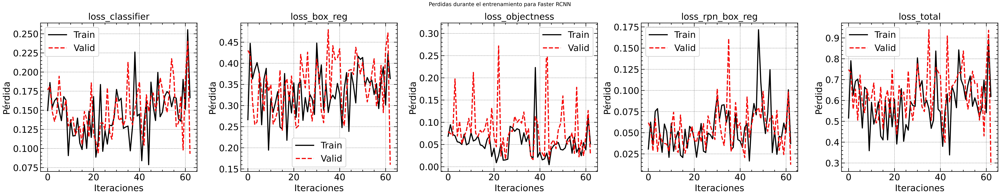

**Paciencia 5 LR = 0.0001**

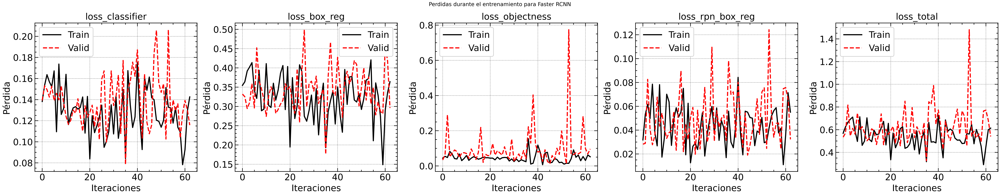


**Paciencia 5 LR = 0.00001**

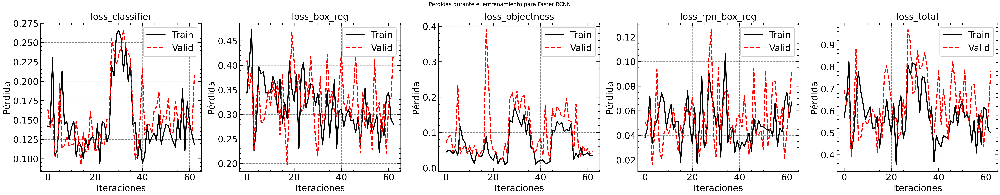

**Paciencia 7 LR = 0.001**

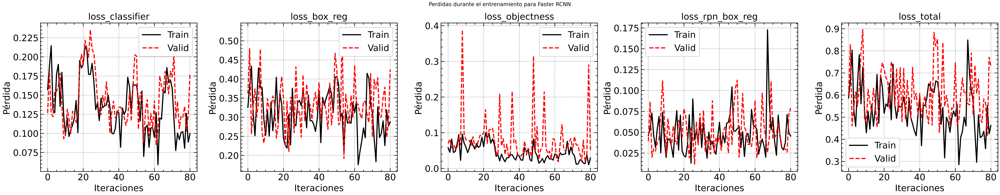

**Paciencia 7 LR = 0.0001**

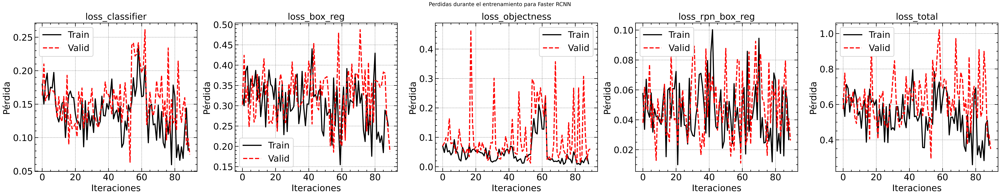

**Paciencia 7 LR = 0.00001**

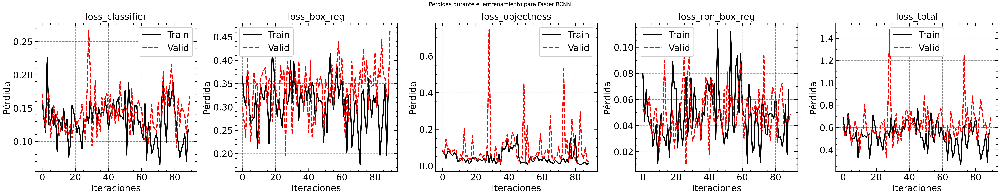

**Paciencia 10 LR = 0.001**

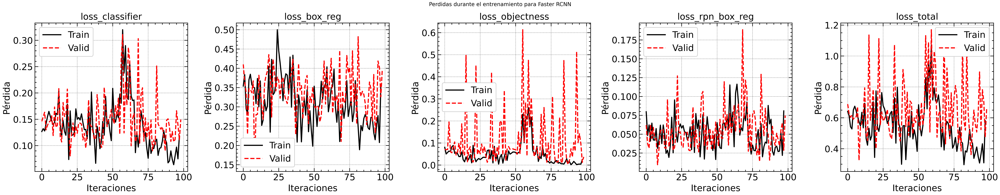

**Paciencia 10 LR = 0.0001**

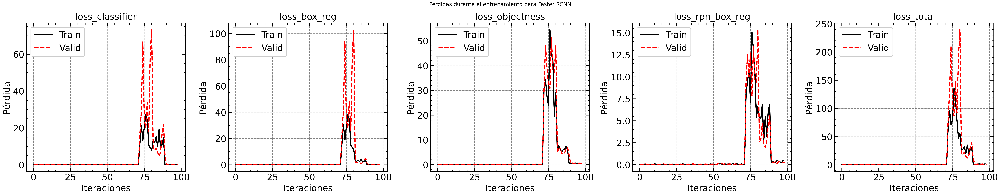

**Paciencia 10 LR = 0.00001**

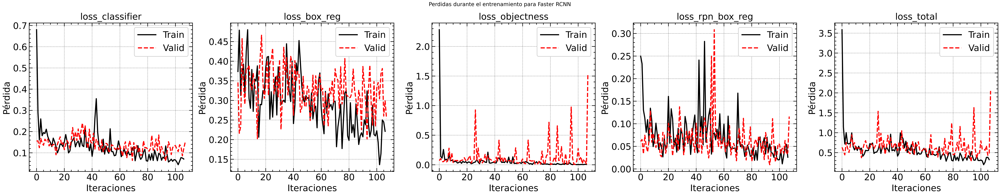

##### Evaluación datos originales

Una vez que hemos entrenado los modelos, vamos a cargar el mejor modelo para realizar la evaluación con todos los conjuntos para tener la información.

Para ello vamos a usar la función `COCOeval` del paquete `pycocotools` la cual nos ofrece una serie de métricas para la evaluación de este modelo ya que `pytorch` no ofrece ninguna herramienta para esta evaluación de forma simple.

In [ ]:
faster_rcnn = best_model

In [ ]:
faster_rcnn = get_model_fasterrcnn(num_classes=2).to(DEVICE)
faster_rcnn.load_state_dict(torch.load(PATH_PROYECTO + f'best_fasterrcnn30_5_0.0001_ORIGINAL.pth'))
faster_rcnn.eval();

<ipython-input-28-ed2bc10011ab>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  faster_rcnn.load_state_dict(torch.load(PATH_PROYECTO + f'best_fasterrcnn30_5_0.0001_ORIGINAL

In [ ]:
def get_predictions_fasterrcnn(model, dataloader, device):
    model.eval()
    all_pred_boxes = []
    all_pred_labels = []
    all_pred_scores = []
    all_true_boxes = []
    all_true_labels = []

    with torch.no_grad():
        for images, targets in dataloader:
            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)

            for prediction, target in zip(predictions, targets):
                all_pred_boxes.append(prediction['boxes'].cpu().numpy())
                all_pred_labels.append(prediction['labels'].cpu().numpy())
                all_pred_scores.append(prediction['scores'].cpu().numpy())
                all_true_boxes.append(target['boxes'].cpu().numpy())
                all_true_labels.append(target['labels'].cpu().numpy())

    return all_pred_boxes, all_pred_labels, all_pred_scores, all_true_boxes, all_true_labels

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

def evaluate_fasterrcnn(model, dataloader, path, device, confidence=0.5):
    model.eval()

    all_pred_boxes, all_pred_labels, all_pred_scores, all_true_boxes, all_true_labels = get_predictions_fasterrcnn(model, dataloader, device)

    coco_gt = COCO(path + '_annotations.coco.json')
    names = []
    ids = []

    for key, val in coco_gt.imgs.items():
        names.append(val['file_name'])
        ids.append(val['id'])

    names = np.array(names)
    ids = np.array(ids)
    idx = np.argsort(names)
    # names = names[idx]
    ids = ids[idx]

    coco_format_predictions = []
    for i, (pred_boxes, pred_labels, pred_scores) in enumerate(zip(all_pred_boxes, all_pred_labels, all_pred_scores)):
        for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
            if score > confidence:
                width = box[2] - box[0]
                height = box[3] - box[1]
                coco_format_predictions.append({
                    'image_id': ids[i],
                    'category_id': label,
                    # 'bbox': box.tolist(),
                    'bbox': [box[0], box[1], width, height],
                    'score': score.item()
                })

    coco_dt = coco_gt.loadRes(coco_format_predictions)

    coco_eval = COCOeval(coco_gt, coco_dt, 'bbox')
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    return coco_eval

In [ ]:
dataloader_train = DataLoader(ds_faster_train, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)
dataloader_valid = DataLoader(ds_faster_valid, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)
dataloader_test =  DataLoader(ds_faster_test,  batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_train,
                                    PATH_PROYECTO + 'train/', DEVICE, confidence=0.3)

loading annotations into memory...
Done (t=0.69s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=9.80s).
Accumulating evaluation results...
DONE (t=0.30s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.863
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.433
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.407
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.623
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.730
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.045
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.316
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets


Como podemos observar, para los datos de entrenamiento, los resultados obtenidos son generalmente buenos. El modelo muestra un rendimiento sólido, especialmente en términos de precisión. Los valores de **Average Precision (AP)** indican que el modelo detecta objetos con una confianza notablemente alta en el rango de IoU más laxo (**IoU=0.50**, con un **AP de 86.3%**). Esto sugiere que, cuando se permite un cierto grado de desajuste en las predicciones, el modelo logra identificar correctamente la mayoría de los objetos en las imágenes.

Sin embargo, al aplicar un criterio más estricto (**IoU=0.75**), el **AP disminuye a 43.3%**, lo que sigue siendo un resultado positivo, aunque refleja que aún existe margen de mejora en la precisión de las predicciones de las bounding boxes. Además, al considerar la métrica global (**IoU=0.50:0.95**), el modelo mantiene un desempeño aceptable con un **AP global de 45.9%**.

En cuanto al análisis del desempeño según el tamaño de los objetos, se observa que el modelo se desempeña mejor con objetos grandes, con un **AP de 73.0%**, seguido de los objetos medianos con un **AP de 62.3%**. Por otro lado, tiene un desempeño algo inferior con objetos pequeños, con un **AP de 40.7%**. Este comportamiento es esperado, ya que los objetos pequeños tienden a ser más desafiantes debido a la menor cantidad de píxeles que los representan y su posible confusión con el ruido de fondo.

En términos de **Average Recall (AR)**, el modelo muestra una capacidad razonable en general, con un **AR de 50.8%** cuando se permite un número elevado de detecciones por imagen (**maxDets=100**). No obstante, el **AR cae drásticamente a 4.5%** cuando se limita a una única detección por imagen (**maxDets=1**), lo que indica que, aunque las detecciones más confiables se encuentran, no siempre logran abarcar todos los objetos presentes en la imagen.

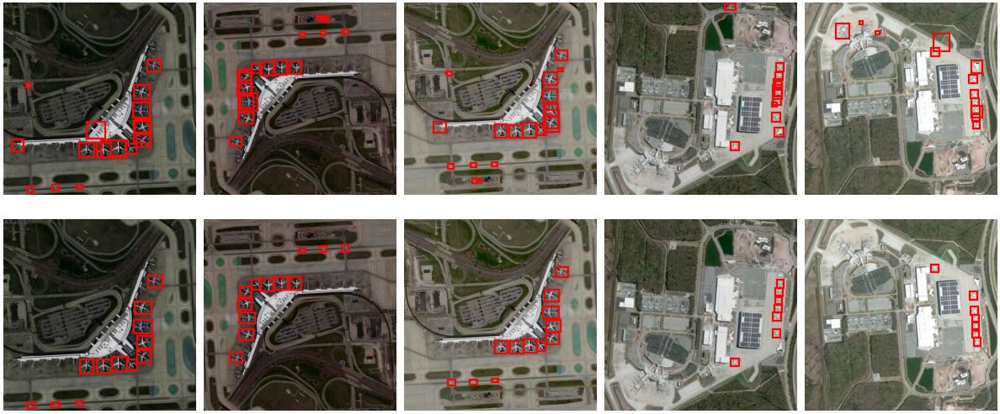

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_train[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_train[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_train[i][0], ds_faster_train[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_valid,
                                    PATH_PROYECTO + 'valid/', DEVICE, confidence=0.3)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.34s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.375
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.265
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.340
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.552
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.037
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.266
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet


Como podemos observar, para los datos de validación, los resultados obtenidos muestran una disminución en el rendimiento del modelo en términos de precisión y recall. Los valores de **Average Precision (AP)** indican que el modelo presenta dificultades en algunos aspectos, pero mantiene un desempeño aceptable en general. En el rango más laxo de IoU (**IoU=0.50**), el modelo alcanza un **AP de 77.7%**, lo que sugiere que es capaz de detectar correctamente una buena proporción de los objetos cuando se permite un cierto desajuste en las predicciones.

Al aplicar un criterio más estricto (**IoU=0.75**), el **AP** disminuye considerablemente a **26.5%**, lo que evidencia que la precisión en el ajuste de las cajas predichas necesita mejorar. Al analizar la métrica global (**IoU=0.50:0.95**), se obtiene un **AP global de 37.5%**, lo que refleja una caída en el desempeño en comparación con los datos de entrenamiento (**45.9%**), lo cual es esperado debido a la naturaleza no vista de los datos de validación.

Al examinar el desempeño según el tamaño de los objetos, vemos que el modelo funciona mejor con objetos medianos (**AP de 55.2%**), mientras que con objetos pequeños, el **AP disminuye a 34.0%**, lo que subraya el desafío que representan estos objetos. Para objetos grandes, el desempeño no fue calculable (**AP=-1.000**), probablemente debido a la **insuficiencia** de ejemplos en esta categoría dentro del conjunto de validación.

En términos de **Average Recall (AR)**, el modelo alcanza un **AR de 43.3%** cuando se permite un número amplio de detecciones por imagen (**maxDets=100**), lo que indica una capacidad razonable para identificar objetos en general. Sin embargo, cuando solo se permite una detección por imagen (**maxDets=1**), el **AR cae drásticamente a 3.7%**, lo que sugiere que las predicciones más confiables del modelo no logran abarcar adecuadamente todos los objetos presentes en las imágenes. Para objetos medianos, el **AR alcanza 60.3%**, mientras que para objetos pequeños es menor (**40.2%**), lo que refleja una tendencia similar a la observada en la métrica de precisión.


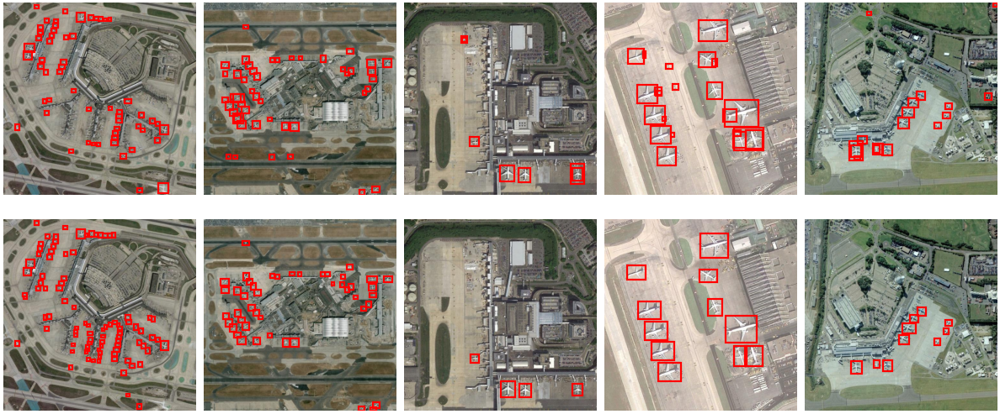

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_valid[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_valid[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_valid[i][0], ds_faster_valid[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_test,
                                    PATH_PROYECTO + 'test/', DEVICE, confidence=0.3)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.45s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.390
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.777
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.334
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.333
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.599
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.202
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.044
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.287
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets


Como podemos observar, para los datos de test, los resultados son sorprendentemente mejores que los obtenidos en validación, aunque con margen de mejora en términos de precisión y recall. Los valores de **Average Precision (AP)** muestran que el modelo mantiene un rendimiento adecuado en la detección de objetos, especialmente cuando se aplican criterios menos estrictos.

El **AP para IoU=0.50** es de **77.7%**, lo que indica que el modelo tiene un buen desempeño para detectar objetos cuando se permite un mayor margen de error en la precisión de las bounding boxes. Sin embargo, cuando se aplica un criterio más estricto (**IoU=0.75**), el **AP cae a 33.4%**. En el caso de la métrica general (**IoU=0.50:0.95**), el modelo logra un **AP global de 39.0%**, lo que muestra un rendimiento moderado en escenarios más variados.

En términos del desempeño según el tamaño de los objetos, observamos las siguientes tendencias:

Para **objetos pequeños**, el modelo alcanza un **AP de 33.3%**, lo que refleja la dificultad inherente a detectar objetos de menor escala.

En el caso de **objetos medianos**, el rendimiento es significativamente mejor, con un **AP de 59.9%**, mostrando que el modelo tiene un buen comportamiento en esta categoría.

Para **objetos grandes**, el **AP desciende a 20.2%**, lo que puede indicar problemas en la detección precisa de objetos grandes o una posible escasez de estos en el conjunto de test.

En cuanto a la **Average Recall (AR)**, el modelo muestra un desempeño moderado.

Cuando se permite un número amplio de detecciones por imagen (**maxDets=100**), el **AR global** es de **44.7%**, lo que sugiere que el modelo identifica aproximadamente la mitad de los objetos esperados en las imágenes.

Con restricciones más estrictas, como **maxDets=1**, el **AR** cae a **4.4%**, lo que refleja que las detecciones más confiables no abarcan suficientemente los objetos presentes.

Por tamaños, los resultados son consistentes con los obtenidos en **AP**.

Para **objetos pequeños**, el **AR** es de **39.8%**, mientras que para **objetos medianos** se alcanza un valor de **64.7%**, evidenciando que el modelo se desempeña mejor con objetos de tamaño mediano.

En el caso de **objetos grandes**, el **AR** es de **20.0%**, un valor bajo que sugiere que el modelo tiene dificultades para identificar objetos de gran escala.


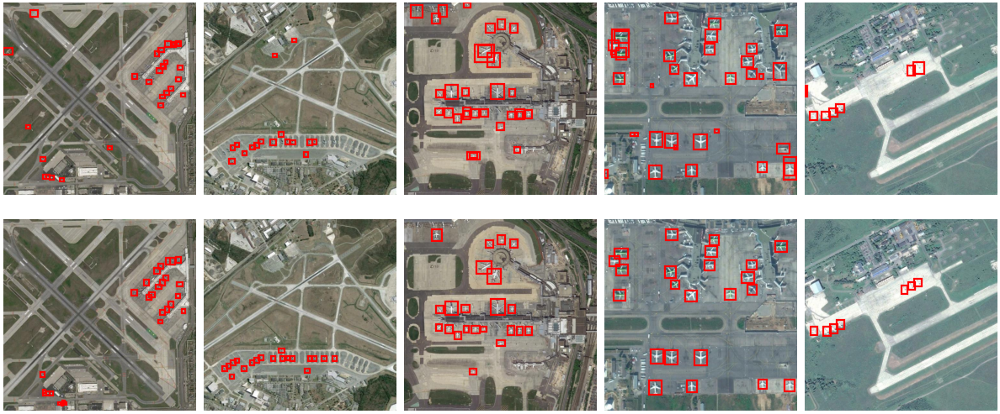

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_test[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_test[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_test[i][0], ds_faster_test[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()

#### Entrenamiento de Faster R-CNN Conjunto Sin Data Augmentations

Una vez que hemos entrenado con el conjunto de datos que tenía aplicada las data augmentations comentadas vamos a evaluar el conjunto de datos original para ver si estas data augmentations realmente han tenido un efecto notable en el rendimiento del modelo.

Para ello vamos a seguir el mismo proceso que el aplicado anteriormente **sin** realizar la búsqueda de los parámetros ya que esta es **muy** costosa y realmente el rendimiento varía muy poco por lo que vamos a usar los mismos parámetros que han dado los mejores resultados en el apartado anterior.

In [ ]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
])

ds_faster_train_sin_da = YoloToFasterRCNN(images_dir=PATH_IMG_TRAIN_SIN_DA, labels_dir=PATH_LABEL_TRAIN_SIN_DA, transform=transform)
ds_faster_valid_sin_da = YoloToFasterRCNN(images_dir=PATH_IMG_VAL_SIN_DA, labels_dir=PATH_LABEL_VAL_SIN_DA, transform=transform)
ds_faster_test_sin_da = YoloToFasterRCNN(images_dir=PATH_IMG_TEST_SIN_DA, labels_dir=PATH_LABEL_TEST_SIN_DA, transform=transform)

In [ ]:
BATCH_SIZE = 8
dataloader_train = DataLoader(ds_faster_train_sin_da, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)
dataloader_valid = DataLoader(ds_faster_valid_sin_da, batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)
dataloader_test =  DataLoader(ds_faster_test_sin_da,  batch_size=BATCH_SIZE, shuffle=True, collate_fn=collate_fn_fasterrccnn)

In [ ]:
NUM_EPOCH = 30
PATIENCE = 5
LR = 0.0001

faster_rcnn = get_model_fasterrcnn(num_classes=2).to(DEVICE)
optimizer = optim.AdamW(faster_rcnn.parameters(), lr=LR)
scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.001,
                                          steps_per_epoch=len(dataloader_train), epochs=NUM_EPOCH)

faster_rcnn, train_loss, valid_loss = train_fasterrcnn(faster_rcnn, dataloader_train, dataloader_valid,
                                                       optimizer, scheduler, PATIENCE, NUM_EPOCH, DEVICE)

torch.save(faster_rcnn.state_dict(), PATH_PROYECTO + f'fasterrcnn{NUM_EPOCH}_{PATIENCE}_{LR}_SIN_DA.pth')

Batch[0/30] loss: 2.8635
Batch[27/30] loss: 0.6774
Epoch 1/30 loss_classifier: 0.1767
loss_box_reg: 0.3899
loss_objectness: 0.0970
loss_rpn_box_reg: 0.0565
loss_total: 0.7200
Validacion
loss_classifier: 0.1841
loss_box_reg: 0.3872
loss_objectness: 0.1246
loss_rpn_box_reg: 0.0553
loss_total: 0.7512
Batch[0/30] loss: 0.7195
Batch[27/30] loss: 0.4703
Epoch 2/30 loss_classifier: 0.1496
loss_box_reg: 0.3943
loss_objectness: 0.0394
loss_rpn_box_reg: 0.0500
loss_total: 0.6333
Validacion
loss_classifier: 0.1643
loss_box_reg: 0.4017
loss_objectness: 0.0696
loss_rpn_box_reg: 0.0446
loss_total: 0.6802
Batch[0/30] loss: 0.8118
Batch[27/30] loss: 0.7714
Epoch 3/30 loss_classifier: 0.1244
loss_box_reg: 0.3464
loss_objectness: 0.0257
loss_rpn_box_reg: 0.0521
loss_total: 0.5486
Validacion
loss_classifier: 0.1431
loss_box_reg: 0.3612
loss_objectness: 0.0728
loss_rpn_box_reg: 0.0567
loss_total: 0.6338
Batch[0/30] loss: 0.6150
Batch[27/30] loss: 0.7284
Epoch 4/30 loss_classifier: 0.1395
loss_box_reg: 0.3

In [ ]:
def plot_losses_fasterrcnn(train_loss, valid_loss, save_path):
    fig, ax = plt.subplots(1, len(train_loss), figsize=(5 * len(train_loss), 5))

    for i, (item, values) in enumerate(train_loss.items()):
        ax[i].plot(values[::3], label='Train')
        ax[i].plot(valid_loss[item], label='Valid')
        ax[i].set_title(item)
        ax[i].set_xlabel('Iteraciones')
        ax[i].set_ylabel('Pérdida')
        ax[i].legend()

    fig.suptitle('Perdidas durante el entrenamiento para Faster RCNN')

    plt.tight_layout()
    plt.legend()
    plt.savefig(save_path, dpi=600)
    plt.show()

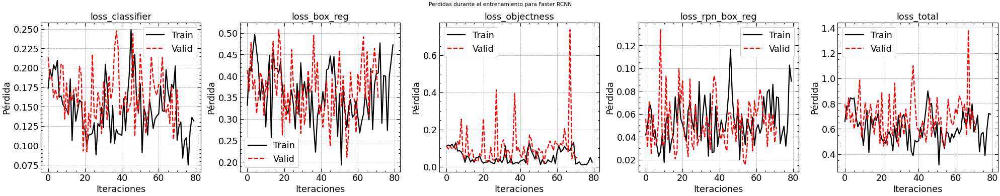

In [ ]:
plot_losses_fasterrcnn(train_loss, valid_loss, PATH_PROYECTO + f'perdidas_faster_rcnn_{NUM_EPOCH}_{PATIENCE}_{LR}_SIN_DA.png')
pd.DataFrame(train_loss).to_csv(PATH_PROYECTO + f'train_loss_{NUM_EPOCH}_{PATIENCE}_{LR}_SIN_DA.csv')
pd.DataFrame(valid_loss).to_csv(PATH_PROYECTO + f'valid_loss_{NUM_EPOCH}_{PATIENCE}_{LR}_SIN_DA.csv')

##### Evaluacion conjunto de datos sin data augmentations

In [ ]:
faster_rcnn = get_model_fasterrcnn(num_classes=2).to(DEVICE)
faster_rcnn.load_state_dict(torch.load(PATH_PROYECTO + f'fasterrcnn30_5_0.0001_SIN_DA.pth'))
faster_rcnn.eval();

<ipython-input-41-83adf153bcd0>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  faster_rcnn.load_state_dict(torch.load(PATH_PROYECTO + f'fasterrcnn30_5_0.001_SIN_DA.pth'))


In [ ]:
dataloader_train = DataLoader(ds_faster_train_sin_da, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)
dataloader_valid = DataLoader(ds_faster_valid_sin_da, batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)
dataloader_test =  DataLoader(ds_faster_test_sin_da,  batch_size=BATCH_SIZE, shuffle=False, collate_fn=collate_fn_fasterrccnn)

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_train,
                                    PATH_PROYECTO_SIN_DA + 'train/', DEVICE)

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=3.57s).
Accumulating evaluation results...
DONE (t=0.12s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.381
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.874
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.204
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.575
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.199
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.035
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.269
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Podemos observar como en este caso los resultados para el conjunto de entrenamiento son considerablemente peores que los obtenidos con el conjunto con las DA clásicas siendo peor prácticamente en todas las ocasiones, destacando los casos más generales con un empeoramiento del 7% en precisión y del 6% en recall.

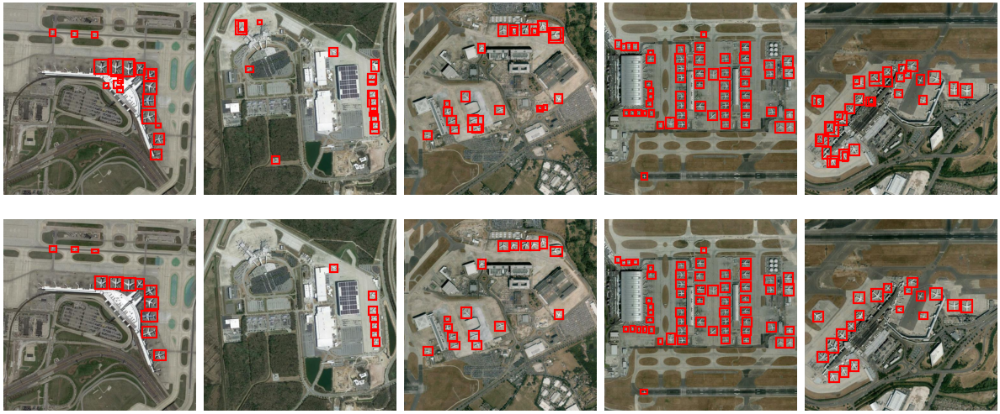

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_train_sin_da[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_train_sin_da[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_train_sin_da[i][0], ds_faster_train_sin_da[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_valid,
                                    PATH_PROYECTO_SIN_DA + 'valid/', DEVICE)

loading annotations into memory...
Done (t=0.41s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.05s).
Accumulating evaluation results...
DONE (t=0.04s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.771
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.132
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.292
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.467
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.030
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.233
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

Volvemos a ver una vez más que los resultados son un poco peores que los obtenidos con el conjunto con las DA, los resultados se mantienen con la empeora de entorno al 6%.

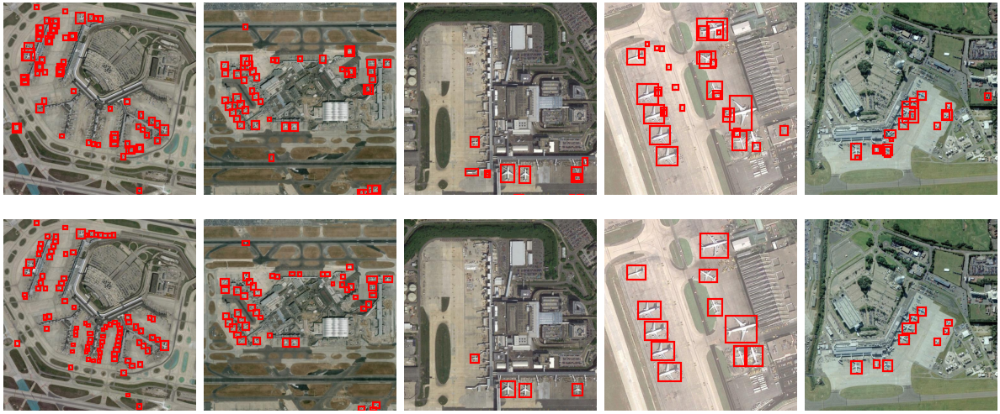

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_valid_sin_da[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_valid_sin_da[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_valid_sin_da[i][0], ds_faster_valid_sin_da[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()

In [ ]:
coco_eval = evaluate_fasterrcnn(faster_rcnn, dataloader_test,
                                    PATH_PROYECTO_SIN_DA + 'test/', DEVICE)

loading annotations into memory...
Done (t=0.30s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.46s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.336
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.805
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.170
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.304
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.505
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.303
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.033
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.253
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Una vez más los resultados se repiten con un empeoramiento de entorno al 6~7% lo que nos indica que estos resultados son consistentes y no casualidad.

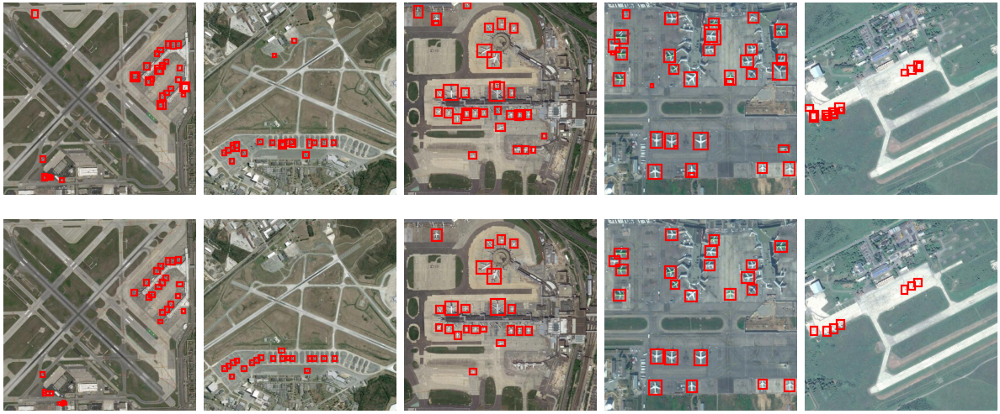

In [ ]:
NUM_IMG = 5

fig, ax = plt.subplots(2, NUM_IMG, figsize=(3 * NUM_IMG, 7))

for i in range(NUM_IMG):
    preds = faster_rcnn([ds_faster_test_sin_da[i][0].to(DEVICE)])
    draw_img_bb_fasterrcnn(ds_faster_test_sin_da[i][0], preds[0]['boxes'], ax=ax[0, i])
    draw_img_bb_fasterrcnn(ds_faster_test_sin_da[i][0], ds_faster_test_sin_da[i][1]['boxes'], ax=ax[1, i])

plt.tight_layout()
plt.show()